# X5.4 Solar Flare Event - March 7, 2012

## Overview
On March 7, 2012, active region **11429** produced an **X5.4 flare** (00:02 UTC), followed by:
- Two fast **Coronal Mass Ejections (CMEs)**:
  - **00:36 UTC** (2200 km/s)
  - **01:25 UTC** (1800 km/s)
- Two high-energy **Solar Energetic Particle (SEP) events**:
  - **01:44 UTC** (13-100 MeV)
  - **04:05 UTC** (>100 MeV)

<img src="https://raw.githubusercontent.com/samresume/SpaceWeather_Multimodality/main/DONKI.png" width="600"/>


Here, we process and show all the data from different sources regarding this flare.

**Data for each section of this notebook is provided in this repository:**  
🔗 [SpaceWeather_Multimodality Repository](https://github.com/samresume/SpaceWeather_Multimodality)

## Features
- **Load and process SWAN-SF MVTS data** (Multivariate Time Series).
- **Download and visualize solar images** from SDO/AIA, HMI, and other sources.
- **Query SHARP magnetic field data** and extract parameters.
- **Analyze solar wind data** from ACE/WIND sources.
- **Extract and plot coronagraph images** from SOHO/LASCO and STEREO.
- **Process sunspot and radio data** for further analysis.
- **Retrieve and visualize GOES X-ray, proton, electron, and heavy ion data.**

## Contact
For any questions or collaborations, feel free to open an issue or contact me at **sameskandarinasab@gmail.com**.


## **Load and process SWAN-SF MVTS**

<ipython-input-10-4d109fe7d172>:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()  # No `rect` parameter to avoid unnecessary title padding


✅ Saved: SWAN-SF/SWAN-SF/Plot_1.jpg


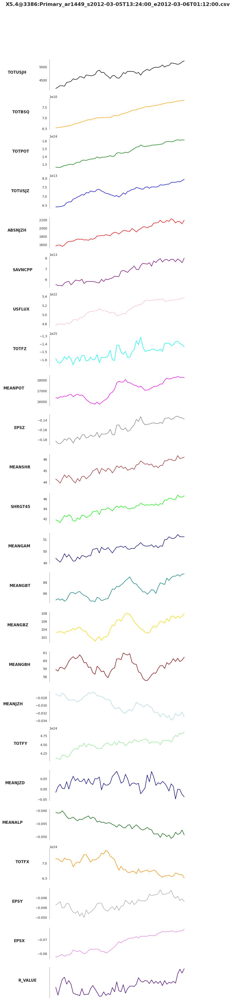

<ipython-input-10-4d109fe7d172>:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()  # No `rect` parameter to avoid unnecessary title padding


✅ Saved: SWAN-SF/SWAN-SF/Plot_2.jpg


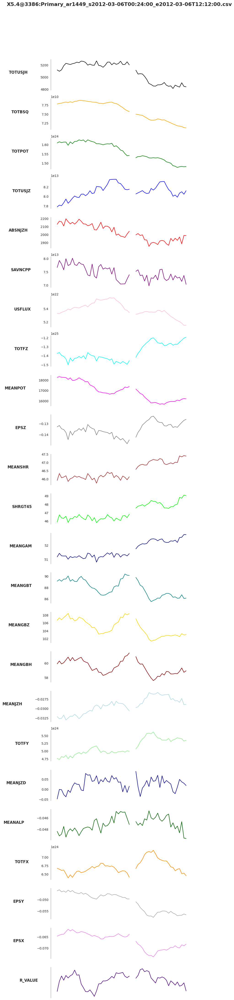

In [ ]:
import os
import zipfile
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style for cleaner visuals
sns.set_style("whitegrid")

# Define the zip file and extraction folder
zip_file = "SWAN-SF.zip"
extract_folder = "SWAN-SF"

# Extract the zip file if not already extracted
if not os.path.exists(extract_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(extract_folder)

# Handle double nested folder (SWAN-SF/SWAN-SF)
nested_folder = os.path.join(extract_folder, extract_folder)
if os.path.exists(nested_folder):
    extract_folder = nested_folder  # Use the correct inner folder

# Define the two target files inside the extracted folder
file_names = [
    "X5.4@3386:Primary_ar1449_s2012-03-05T13:24:00_e2012-03-06T01:12:00.csv",
    "X5.4@3386:Primary_ar1449_s2012-03-06T00:24:00_e2012-03-06T12:12:00.csv"
]

# Define colors for plots
colors = [
    "black", "orange", "green", "blue", "red", "purple", "pink", "cyan",
    "magenta", "gray", "brown", "lime", "navy", "teal", "gold", "darkred",
    "lightblue", "lightgreen", "darkblue", "darkgreen", "darkorange", "darkgray", "violet", "indigo"
]

# Iterate through both files and generate the plots
for i, file_name in enumerate(file_names):
    file_path = os.path.join(extract_folder, file_name)

    # Ensure the file exists
    if not os.path.exists(file_path):
        print(f"⚠️ Warning: File not found - {file_path}. Skipping.")
        continue

    # Load the CSV file (tab-separated)
    df = pd.read_csv(file_path, delimiter="\t")

    # Extract the first 24 features (excluding the timestamp)
    selected_features = df.columns[1:25]

    # Create a figure with 24 subplots (1 column)
    fig, axes = plt.subplots(24, 1, figsize=(8, 50), sharex=True, gridspec_kw={'hspace': 0.3})
    fig.suptitle(f"{file_name}", fontsize=16, fontweight="bold")

    # Reduce the extra space between the title and first subplot
    plt.subplots_adjust(top=0.93)

    # Plot each feature in a separate subplot
    for j, feature in enumerate(selected_features):
        axes[j].plot(df.index, df[feature], color=colors[j], linewidth=1.5)
        axes[j].set_ylabel(feature, fontsize=12, fontweight="bold", rotation=0, labelpad=40, ha='right')
        axes[j].spines["top"].set_visible(False)
        axes[j].spines["right"].set_visible(False)
        axes[j].spines["left"].set_linewidth(2)  # Thick left border
        axes[j].spines["bottom"].set_visible(False)
        axes[j].grid(False)

        # Hide x-axis labels except for the last plot
        if j != len(selected_features) - 1:
            axes[j].set_xticklabels([])

    # Adjust layout for a cleaner look
    plt.xticks(fontsize=10)
    plt.yticks([])
    plt.tight_layout()  # No `rect` parameter to avoid unnecessary title padding

    # Save the plot as JPG
    output_filename = os.path.join(extract_folder, f"Plot_{i+1}.jpg")
    plt.savefig(output_filename, format="jpg", dpi=300, bbox_inches="tight")
    print(f"✅ Saved: {output_filename}")

    # Show the plot
    plt.show()

## **Visualize solar images from SDO/AIA and HMI**

✅ Saved: SDO_HMI_94.jpg


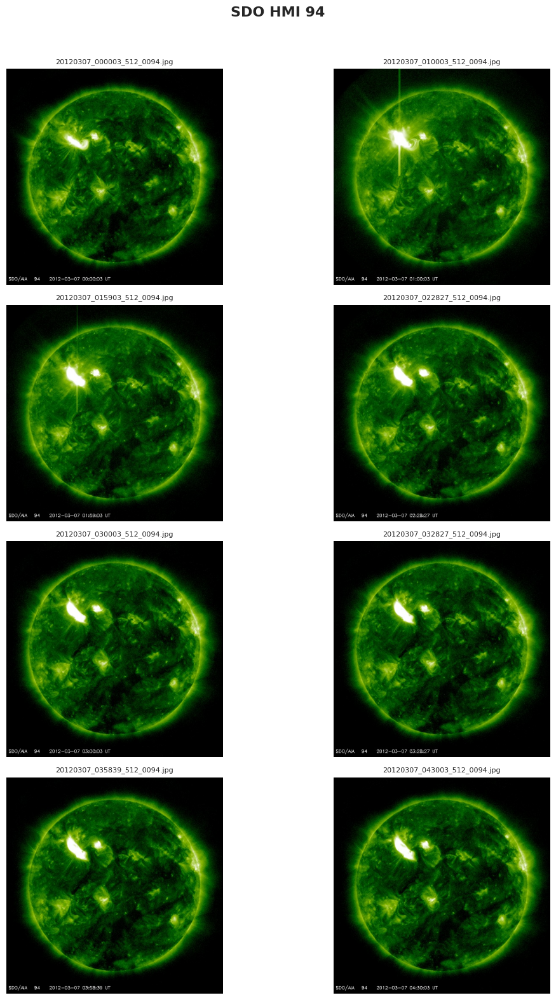

✅ Saved: SDO_HMI_304.jpg


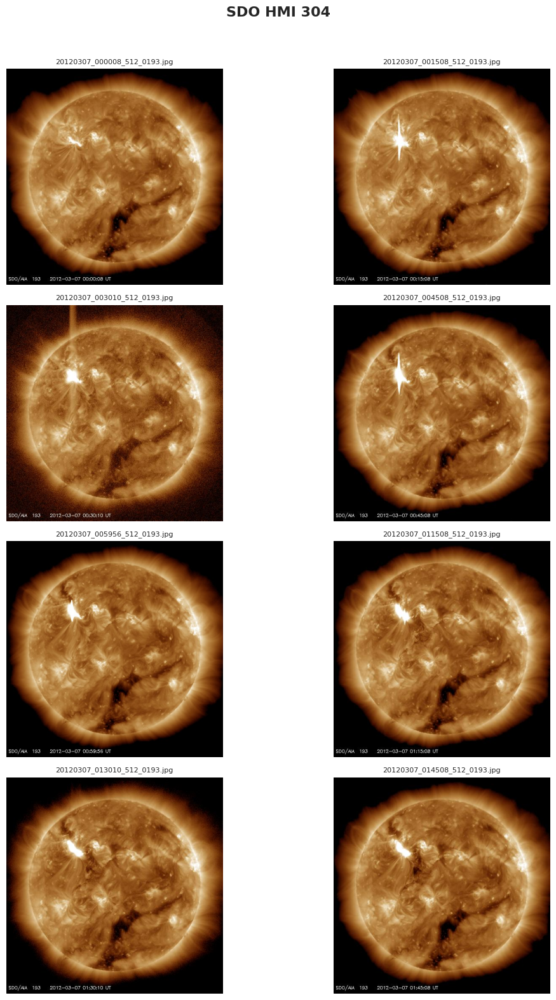

✅ Saved: SDO_HMI_193.jpg


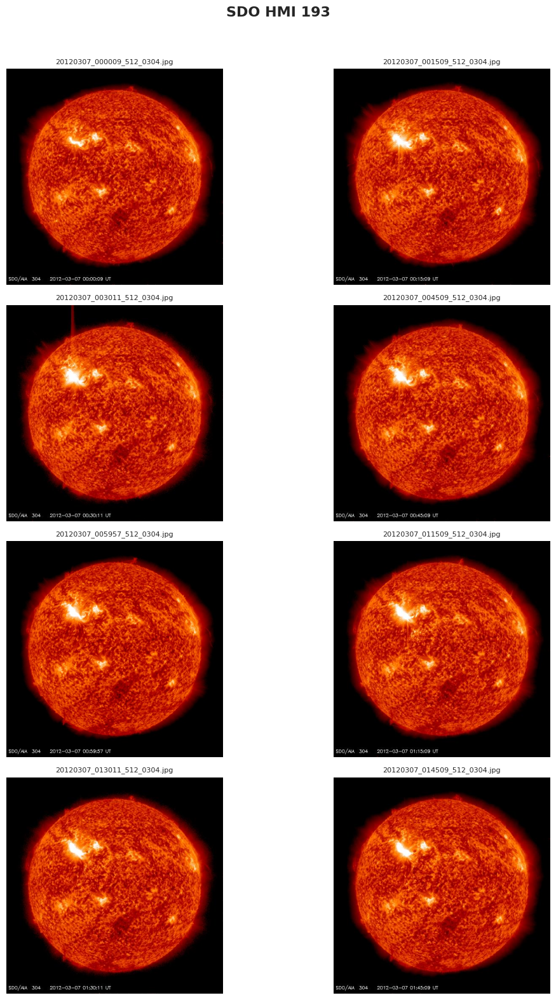

In [ ]:
import os
import zipfile
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# Set Seaborn style
sns.set_style("darkgrid")

# Define ZIP files and their corresponding extraction folders
zip_files = ["HMI94.zip", "HMI304.zip", "HMI193.zip"]
extract_folders = ["HMI94", "HMI304", "HMI193"]
titles = ["SDO HMI 94", "SDO HMI 304", "SDO HMI 193"]  # Titles for each dataset

# Function to extract files and get image paths
def extract_and_get_images(zip_file, extract_folder):
    """Extracts the ZIP file and returns sorted image paths from the correct subdirectory."""
    if not os.path.exists(extract_folder):  # Unzip only if not extracted
        with zipfile.ZipFile(zip_file, 'r') as zip_ref:
            zip_ref.extractall(extract_folder)

    # Locate the second-level nested folder
    nested_folder = os.path.join(extract_folder, extract_folder)

    if not os.path.exists(nested_folder):
        print(f"⚠️ Warning: Expected nested folder '{nested_folder}' not found. Skipping.")
        return []

    # Get all image files inside the nested folder
    image_files = sorted(
        [os.path.join(nested_folder, f) for f in os.listdir(nested_folder) if f.lower().endswith(('.jpg', '.png'))]
    )

    return image_files

# Loop through each dataset and create a separate 4×2 plot
for zip_file, folder, title in zip(zip_files, extract_folders, titles):
    image_paths = extract_and_get_images(zip_file, folder)

    # Ensure exactly 8 images are found
    if len(image_paths) != 8:
        print(f"⚠️ Warning: Expected 8 images in {folder}, but found {len(image_paths)}. Skipping.")
        continue  # Skip if the count is incorrect

    # Create a 4×2 figure
    fig, axes = plt.subplots(4, 2, figsize=(12, 16))  # Adjusted to 4×2
    fig.suptitle(title, fontsize=16, fontweight="bold")  # Add title

    # Plot each image in the 4×2 grid
    for i, ax in enumerate(axes.flatten()):
        img = Image.open(image_paths[i])
        ax.imshow(img)
        ax.axis("off")  # Hide axis
        ax.set_title(os.path.basename(image_paths[i]), fontsize=8)

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Prevent title overlap

    # Save the plot as a JPG file
    output_filename = f"{title.replace(' ', '_')}.jpg"
    plt.savefig(output_filename, format='jpg', dpi=300)
    print(f"✅ Saved: {output_filename}")

    # Show the plot
    plt.show()

## **Visualize SHARP Images**

In [ ]:
!pip install astropy sunpy requests numpy matplotlib

Approximating Bp as Bx.
Approximating Br as Bz.
Approximating Bt as -By.
✅ Magnetogram saved as: hmi_magnetogram_AR11429.jpg


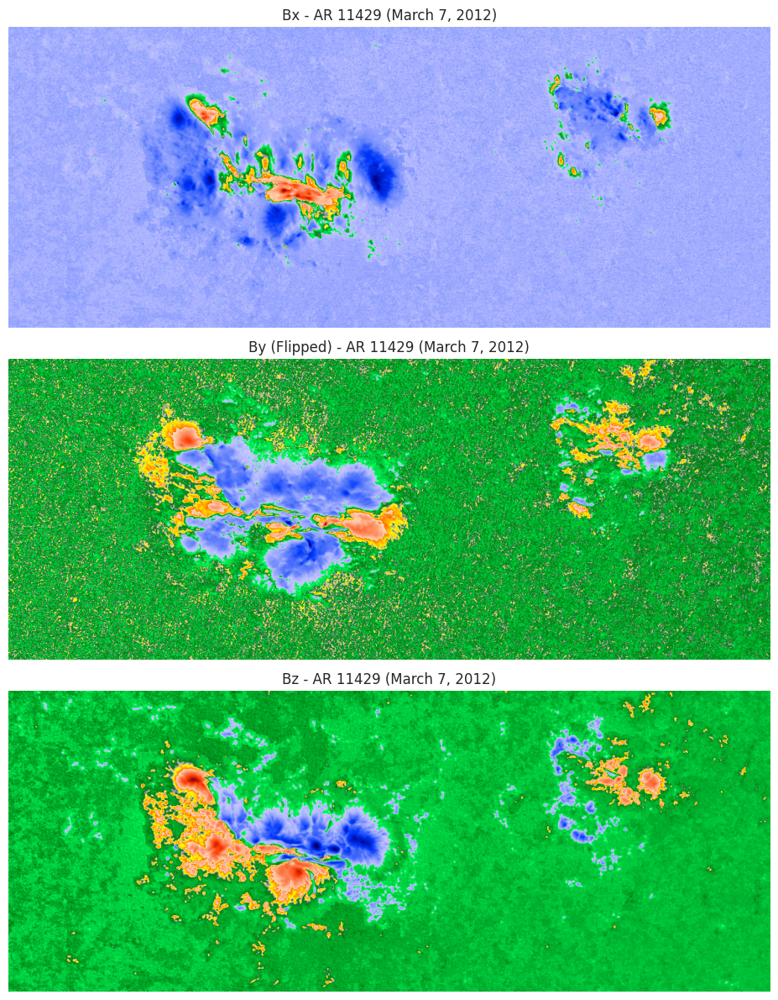

In [ ]:
import json
import numpy as np
import matplotlib.pyplot as plt
import requests
from astropy.io import fits
from sunpy.visualization.colormaps import color_tables as ct

# Use the correct SunPy colormap for HMI magnetograms
hmimag = ct.hmi_mag_color_table()

def get_the_data():
    """Fetch solar magnetogram data from JSOC and return file URLs."""
    url = "http://jsoc.stanford.edu/cgi-bin/ajax/jsoc_info?ds=hmi.sharp_cea_720s[1449][2012.03.07_00:00_TAI]&op=rs_list&key=NOAA_ARS,T_REC&seg=Bp,Br,Bt"
    response = requests.get(url)
    data = response.json()

    print("Approximating", data['segments'][0]['name'], "as Bx.")
    print("Approximating", data['segments'][1]['name'], "as Bz.")
    print("Approximating", data['segments'][2]['name'], "as -By.")

    # URLs of FITS files
    bx_url = "http://jsoc.stanford.edu" + data['segments'][0]['values'][0]
    bz_url = "http://jsoc.stanford.edu" + data['segments'][1]['values'][0]
    by_url = "http://jsoc.stanford.edu" + data['segments'][2]['values'][0]

    return bx_url, by_url, bz_url

# Step 1: Get the FITS file URLs
bx_url, by_url, bz_url = get_the_data()

# Step 2: Load the FITS files
bx_fits = fits.open(bx_url)
bz_fits = fits.open(bz_url)
by_fits = fits.open(by_url)

# Step 3: Extract the data from FITS
bx = bx_fits[1].data
bz = bz_fits[1].data
by = -1.0 * by_fits[1].data  # Flip the sign of By

# Step 4: Plot the HMI vector magnetogram components using SunPy colormaps
fig, axes = plt.subplots(3, 1, figsize=(12, 12))

axes[0].set_title('Bx - AR 11429 (March 7, 2012)')
axes[0].imshow(bx, cmap=hmimag, origin='lower')
axes[0].axis("off")  # Remove axes

axes[1].set_title('By (Flipped) - AR 11429 (March 7, 2012)')
axes[1].imshow(by, cmap=hmimag, origin='lower')
axes[1].axis("off")

axes[2].set_title('Bz - AR 11429 (March 7, 2012)')
axes[2].imshow(bz, cmap=hmimag, origin='lower')
axes[2].axis("off")

plt.tight_layout()

# ✅ Save the figure as a high-resolution JPG
output_filename = "hmi_magnetogram_AR11429.jpg"
plt.savefig(output_filename, format="jpg", dpi=300, bbox_inches="tight")
print(f"✅ Magnetogram saved as: {output_filename}")

# Show the plot
plt.show()

## **Analyze solar wind data from ACE/WIND**

✅ Found file: /content/Solar_wind_ACE/20120307_ace_swepam_1m.txt


<ipython-input-2-dc631b1521af>:26: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)


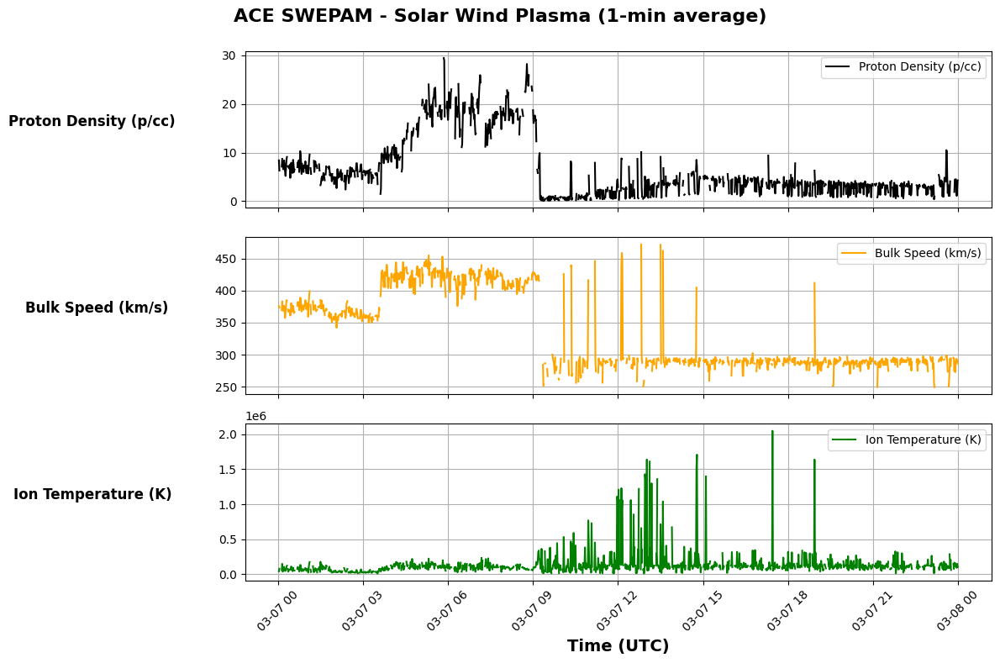

✅ Saved plot: /content/ACE_SWEPAM_Plot.jpg


In [ ]:
import zipfile
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define paths for the ZIP file and extraction directory
zip_file = "/content/Solar_wind_ACE.zip"  # Root directory of Google Colab project
extract_folder = "/content/Solar_wind_ACE"

# Step 1: Unzip the file if not already extracted
if not os.path.exists(extract_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(extract_folder)

# Step 2: Find the correct folder inside the extracted directory
for root, dirs, files in os.walk(extract_folder):
    if "20120307_ace_swepam_1m.txt" in files:
        file_path = os.path.join(root, "20120307_ace_swepam_1m.txt")
        break
else:
    raise FileNotFoundError("⚠️ File '20120307_ace_swepam_1m.txt' not found inside the ZIP archive.")

print(f"✅ Found file: {file_path}")

# Step 3: Load the dataset
df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)

# Assign column names
df.columns = ["Year", "Month", "Day", "Time", "Julian_Day", "Seconds", "Status",
              "Proton Density (p/cc)", "Bulk Speed (km/s)", "Ion Temperature (K)"]

# Convert timestamp columns into a proper datetime index
df["Timestamp"] = pd.to_datetime(df[["Year", "Month", "Day"]]) + pd.to_timedelta(df["Seconds"], unit="s")
df.set_index("Timestamp", inplace=True)

# Select only the important scientific features
df = df[["Proton Density (p/cc)", "Bulk Speed (km/s)", "Ion Temperature (K)"]]

# Replace missing data values with NaN
df.replace([-9999.9, -1.00e+05], float("nan"), inplace=True)

# Step 4: Plot the data
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(12, 8), sharex=True)
fig.suptitle("ACE SWEPAM - Solar Wind Plasma (1-min average)", fontsize=16, fontweight="bold")

colors = ["black", "orange", "green"]

for i, (col, ax) in enumerate(zip(df.columns, axes)):
    ax.plot(df.index, df[col], color=colors[i], label=col, linewidth=1.5)
    ax.set_ylabel(col, fontsize=12, fontweight="bold", rotation=0, labelpad=40, ha='right')
    ax.grid(True)
    ax.legend(loc="upper right", fontsize=10)

plt.xlabel("Time (UTC)", fontsize=14, fontweight="bold")
plt.xticks(rotation=45)
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Save the plot as a JPG file in Google Colab
output_filename = "/content/ACE_SWEPAM_Plot.jpg"
plt.savefig(output_filename, format="jpg", dpi=300)

# Display the plot
plt.show()

print(f"✅ Saved plot: {output_filename}")

<ipython-input-3-bfc25e8d0fc3>:51: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)


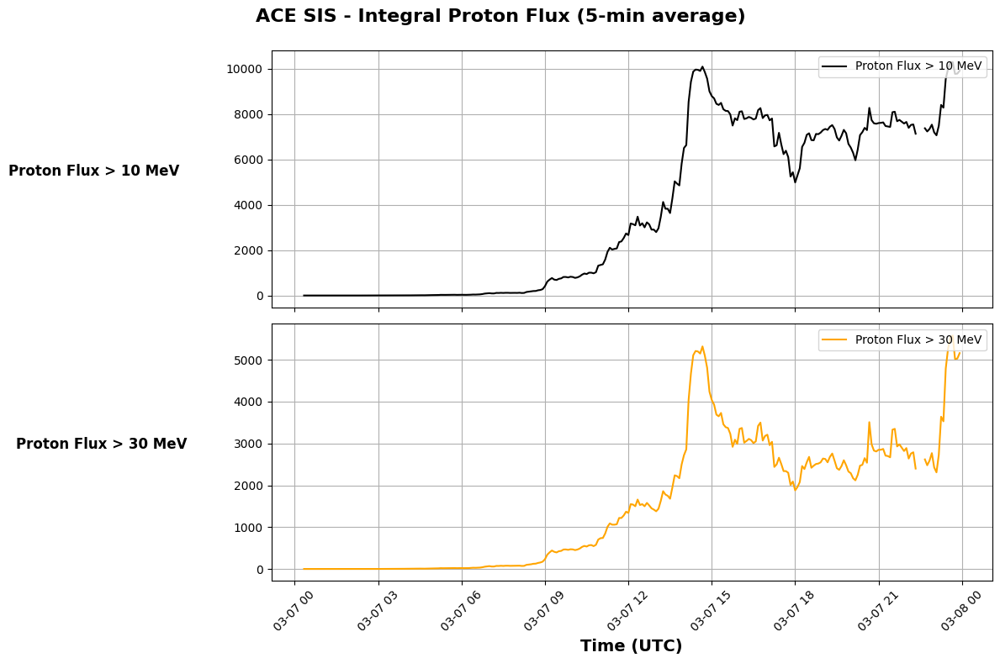

<ipython-input-3-bfc25e8d0fc3>:51: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)


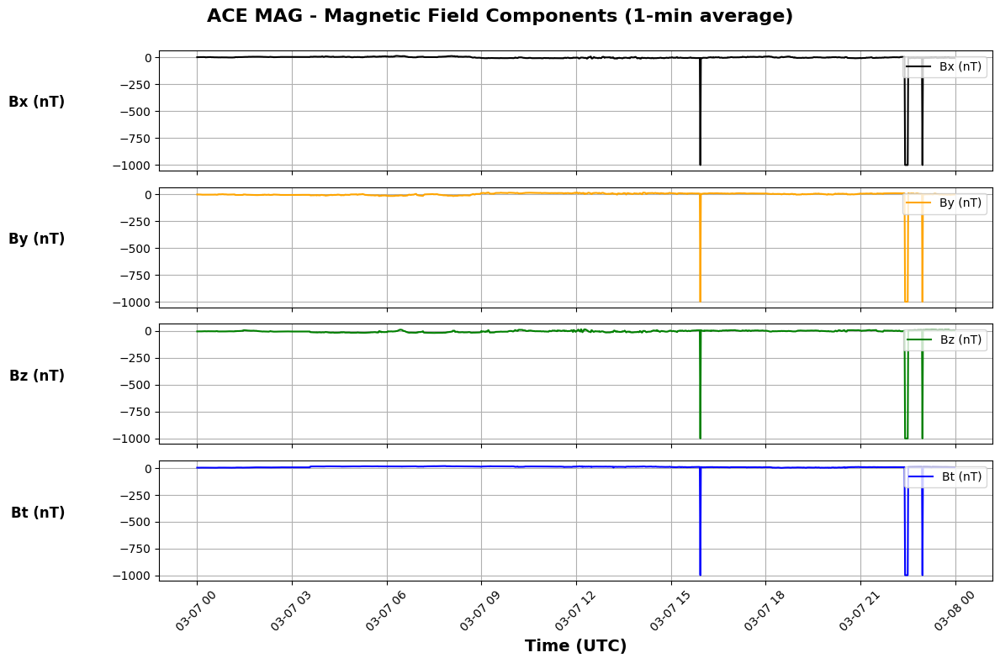

<ipython-input-3-bfc25e8d0fc3>:51: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)


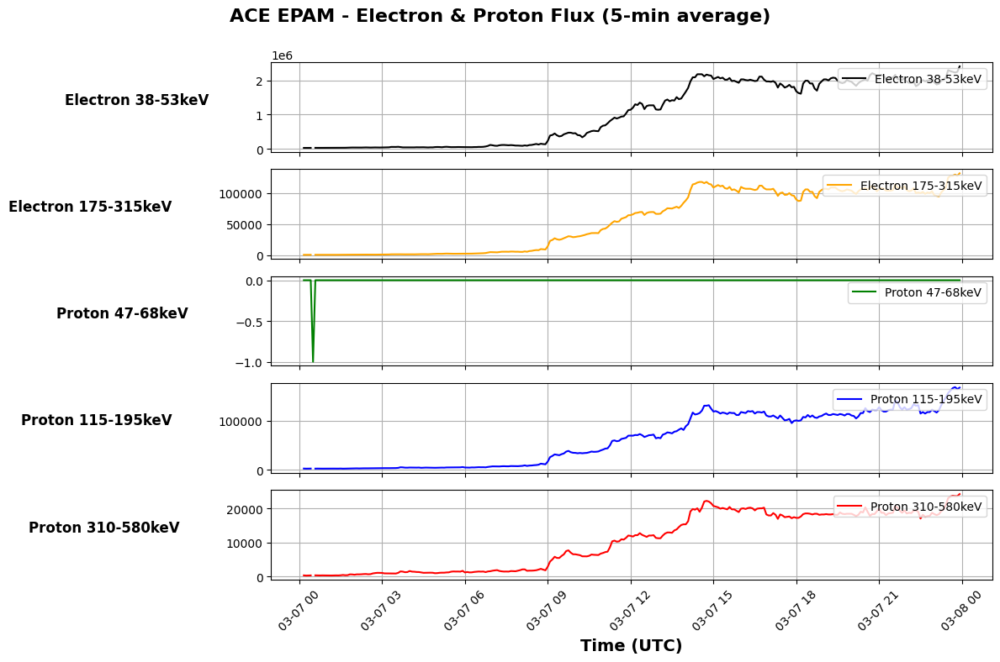

{'ACE_SIS': '/content/ACE_SIS_Plot.jpg',
 'ACE_MAG': '/content/ACE_MAG_Plot.jpg',
 'ACE_EPAM': '/content/ACE_EPAM_Plot.jpg'}

In [ ]:
import zipfile
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the zip file and extraction folder
zip_file = "/content/Solar_wind_ACE.zip"  # Root directory of Google Colab
extract_folder = "/content/Solar_wind_ACE"

# Step 1: Unzip the file if it's not already extracted
if not os.path.exists(extract_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(extract_folder)

# Step 2: Locate the datasets inside the extracted folder
file_paths = {}
for root, dirs, files in os.walk(extract_folder):
    for file in files:
        if file.endswith(".txt"):
            file_paths[file] = os.path.join(root, file)

# Define datasets and features
datasets = {
    "ACE_SIS": {
        "file": "20120307_ace_sis_5m.txt",
        "title": "ACE SIS - Integral Proton Flux (5-min average)",
        "features": ["Proton Flux > 10 MeV", "Proton Flux > 30 MeV"],
        "expected_cols": 10
    },
    "ACE_MAG": {
        "file": "20120307_ace_mag_1m.txt",
        "title": "ACE MAG - Magnetic Field Components (1-min average)",
        "features": ["Bx (nT)", "By (nT)", "Bz (nT)", "Bt (nT)"],
        "expected_cols": 13
    },
    "ACE_EPAM": {
        "file": "20120307_ace_epam_5m.txt",
        "title": "ACE EPAM - Electron & Proton Flux (5-min average)",
        "features": ["Electron 38-53keV", "Electron 175-315keV",
                     "Proton 47-68keV", "Proton 115-195keV", "Proton 310-580keV"],
        "expected_cols": 16
    }
}

# Define colors for plotting
colors = ["black", "orange", "green", "blue", "red", "purple"]

# Function to load and plot data dynamically
def load_and_plot_data_auto(file_path, dataset_name, details):
    # Read the data while skipping the header and using whitespace as the delimiter
    df = pd.read_csv(file_path, delim_whitespace=True, skiprows=20, header=None)

    # Dynamically detect the number of columns
    num_columns = df.shape[1]

    # Assign appropriate column names based on detected number of columns
    if num_columns == details["expected_cols"]:
        if dataset_name == "ACE_SIS":
            df.columns = ["Year", "Month", "Day", "Time", "Julian_Day", "Seconds", "Status",
                          "Proton Flux > 10 MeV", "S1", "Proton Flux > 30 MeV"]
        elif dataset_name == "ACE_MAG":
            df.columns = ["Year", "Month", "Day", "Time", "Julian_Day", "Seconds", "Status",
                          "Bx (nT)", "By (nT)", "Bz (nT)", "Bt (nT)", "Latitude (deg)", "Longitude (deg)"]
        elif dataset_name == "ACE_EPAM":
            df.columns = ["Year", "Month", "Day", "Time", "Julian_Day", "Seconds", "Status",
                          "Electron 38-53keV", "Electron 175-315keV",
                          "Proton 47-68keV", "Proton 115-195keV", "Proton 310-580keV",
                          "Proton 795-1193keV", "Proton 1060-1900keV", "Anisotropy Index", "Extra"]
    else:
        print(f"⚠️ Unexpected number of columns ({num_columns}) for dataset: {dataset_name}. Skipping.")
        return None

    # Convert timestamp columns into a proper datetime index
    df["Timestamp"] = pd.to_datetime(df[["Year", "Month", "Day"]]) + pd.to_timedelta(df["Seconds"], unit="s")
    df.set_index("Timestamp", inplace=True)

    # Select only the relevant scientific features
    selected_features = details["features"]
    df = df[selected_features]

    # Replace missing data values with NaN
    df.replace([-9999.9, -1.00e+05], float("nan"), inplace=True)

    # Plot the data
    fig, axes = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(12, 8), sharex=True)
    fig.suptitle(details["title"], fontsize=16, fontweight="bold")

    for i, (col, ax) in enumerate(zip(df.columns, axes)):
        ax.plot(df.index, df[col], color=colors[i % len(colors)], label=col, linewidth=1.5)
        ax.set_ylabel(col, fontsize=12, fontweight="bold", rotation=0, labelpad=40, ha='right')
        ax.grid(True)
        ax.legend(loc="upper right", fontsize=10)

    plt.xlabel("Time (UTC)", fontsize=14, fontweight="bold")
    plt.xticks(rotation=45)
    plt.tight_layout(rect=[0, 0, 1, 0.98])

    # Save the plot
    output_filename = f"/content/{dataset_name}_Plot.jpg"
    plt.savefig(output_filename, format="jpg", dpi=300)
    plt.show()

    return output_filename

# Generate plots for each dataset
output_files = {}
for dataset, details in datasets.items():
    if details["file"] in file_paths:
        output_files[dataset] = load_and_plot_data_auto(file_paths[details["file"]], dataset, details)
    else:
        print(f"⚠️ File {details['file']} not found. Skipping {dataset}.")

# Display output file paths
output_files

## **Plot coronagraph images from SOHO/LASCO and STEREO**

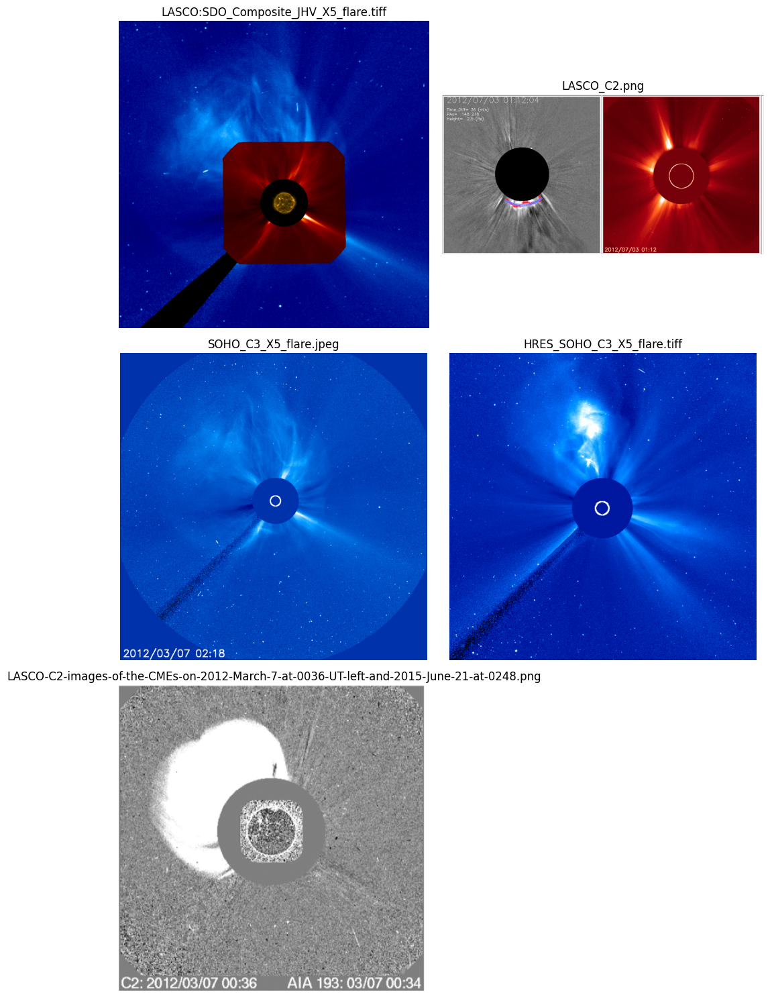

In [1]:
# src: http://helio.gmu.edu/seeds/dailymkmovie_ql.php?cme=20120703
# src: https://soho.nascom.nasa.gov/pickoftheweek/old/07mar2012/

import zipfile
import os
import matplotlib.pyplot as plt
from PIL import Image, UnidentifiedImageError
import numpy as np  # Make sure numpy is imported

# Define ZIP file and extraction folder
zip_path = "coronagraph.zip"
extract_path = "coronagraph_extracted"

# Extract ZIP file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

# Search for valid image files (ignore macOS hidden files)
image_extensions = ('.jpeg', '.jpg', '.png', '.tiff', '.tif')
image_files = []

for root, _, files in os.walk(extract_path):
    for file in files:
        if file.lower().endswith(image_extensions) and not file.startswith("._"):
            image_files.append(os.path.join(root, file))  # Save full path

# Print found images
if not image_files:
    print("No valid image files found.")

# Function to display images in 2 columns per row
def display_images(image_files, num_images=6):
    num_images = min(num_images, len(image_files))  # Limit to available images
    cols = 2  # 2 images per row
    rows = (num_images + cols - 1) // cols  # Ensure correct number of rows

    fig, axes = plt.subplots(rows, cols, figsize=(10, 5 * rows))

    # Flatten axes if multiple rows, else make it a list
    axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

    for i in range(len(axes)):
        if i < num_images:
            img_path = image_files[i]
            try:
                image = Image.open(img_path)
                axes[i].imshow(image)
                axes[i].axis("off")
                axes[i].set_title(os.path.basename(img_path))
            except UnidentifiedImageError:
                print(f"Skipping invalid image: {img_path}")
                axes[i].axis("off")  # Hide this subplot
        else:
            axes[i].axis("off")  # Hide empty subplots

    plt.tight_layout()
    plt.show()

# Display first few images
if image_files:
    display_images(image_files)

In [2]:
import os
import IPython.display as display

# Define video extensions to search for
video_extensions = ('.mp4', '.m4v')

# Search for video files in the extracted folder
video_files = []
for root, _, files in os.walk(extract_path):
    for file in files:
        if file.lower().endswith(video_extensions) and not file.startswith("._"):
            video_files.append(os.path.join(root, file))  # Store full path

# Display videos if found
if video_files:
    print("Found video files:\n")
    for video_path in video_files:
        print(os.path.basename(video_path))  # Print filename
        display.display(display.Video(video_path, embed=True, width=600))  # Show video
else:
    print("No video files found.")

Found video files:

JHV_X5_flare.mp4


C3_X5_flare.m4v


## **Plot sunspot data**

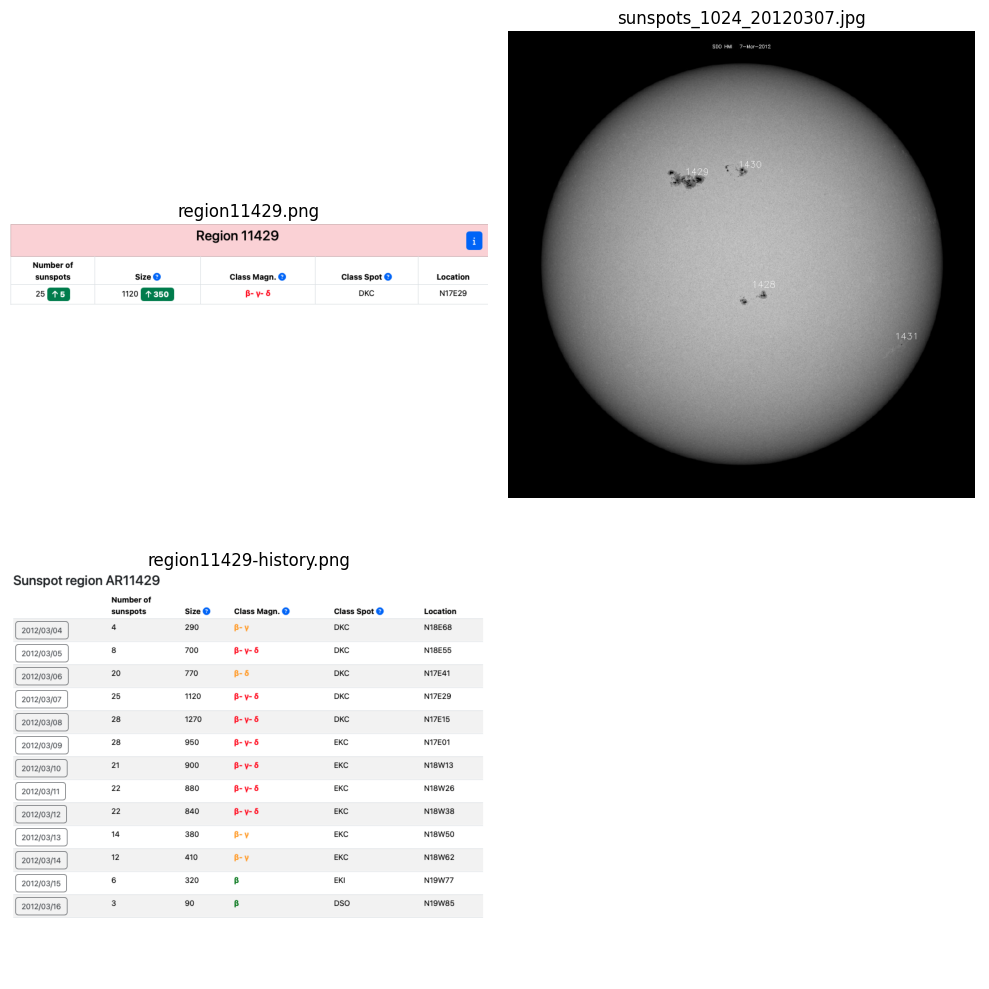

In [3]:
# src: https://www.spaceweatherlive.com/en/archive/2012/03/07/dayobs.html
# src: https://www.swpc.noaa.gov/products/solar-region-summary
import zipfile
import os
import matplotlib.pyplot as plt
from PIL import Image, UnidentifiedImageError
import numpy as np  # Make sure numpy is imported

# Define ZIP file and extraction folder
zip_path = "sunspot.zip"
extract_path = "sunspot_extracted"

# Extract ZIP file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

# Search for valid image files (ignore macOS hidden files)
image_extensions = ('.jpeg', '.jpg', '.png', '.tiff', '.tif')
image_files = []

for root, _, files in os.walk(extract_path):
    for file in files:
        if file.lower().endswith(image_extensions) and not file.startswith("._"):
            image_files.append(os.path.join(root, file))  # Save full path

# Print found images
if not image_files:
    print("No valid image files found.")

# Function to display images in 2 columns per row
def display_images(image_files, num_images=6):
    num_images = min(num_images, len(image_files))  # Limit to available images
    cols = 2  # 2 images per row
    rows = (num_images + cols - 1) // cols  # Ensure correct number of rows

    fig, axes = plt.subplots(rows, cols, figsize=(10, 5 * rows))

    # Flatten axes if multiple rows, else make it a list
    axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

    for i in range(len(axes)):
        if i < num_images:
            img_path = image_files[i]
            try:
                image = Image.open(img_path)
                axes[i].imshow(image)
                axes[i].axis("off")
                axes[i].set_title(os.path.basename(img_path))
            except UnidentifiedImageError:
                print(f"Skipping invalid image: {img_path}")
                axes[i].axis("off")  # Hide this subplot
        else:
            axes[i].axis("off")  # Hide empty subplots

    plt.tight_layout()
    plt.show()

# Display first few images
if image_files:
    display_images(image_files)

## **Visualize radio data**

CULGOORA RADIOSPECTROGRAPH OBSERVATIONS MARCH 2012

120325  2020 2400   CULG   2210.0    2214.0      III    G             1       20      60   
120325              CULG   2213.0    2213.0      III    B             1       20     180   
120325              CULG   2216.0    2218.0      III    G             2       18      80   
120325              CULG   2304.0    2305.0      III    G             1       25      70   
120326  0000 0800   CULG   0249.0    0249.0      III    G             1       20      60   
120326              CULG   0556.0    0556.0      III    B             1       23      60   
120326              CULG   0608.0    0635.0      III    S             1       20     180   
120326              CULG   0639.0    0708.0      III    N             1       20      70   
120326  2020 2400   CULG   2120.0    2120.0      III    B             1       23      90   
120326              CULG   2211.0    2307.0      III    N             1       20     150   
120326              CULG   2

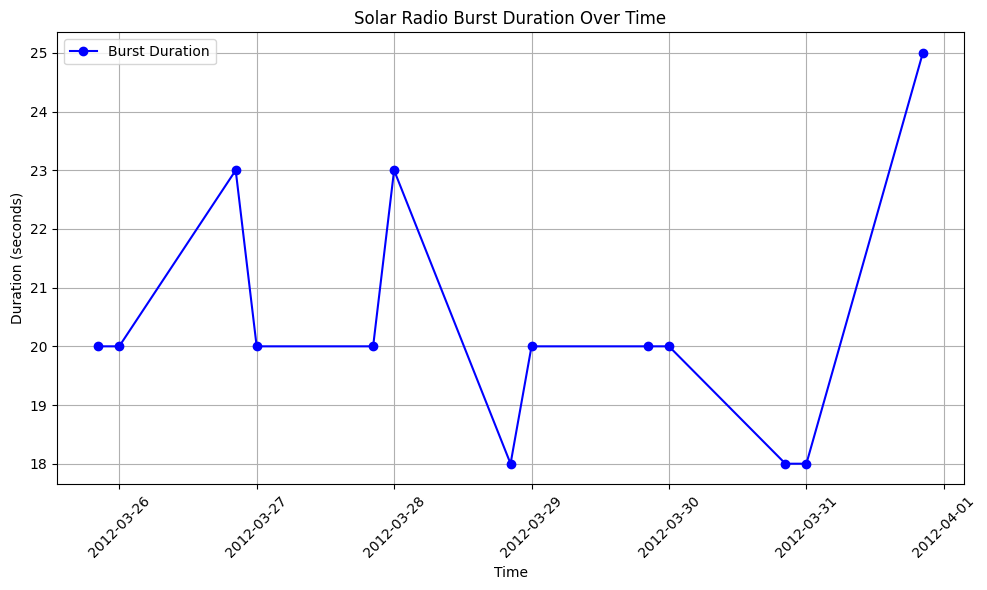

                      timestamp  frequency_start  frequency_end  intensity  \
datetime                                                                     
2012-03-25 20:20:24  1332706824           2210.0         2214.0          1   
2012-03-26 00:00:08  1332720008            249.0          249.0          1   
2012-03-26 20:20:24  1332793224           2120.0         2120.0          1   
2012-03-27 00:00:08  1332806408            232.0          308.0          1   
2012-03-27 20:20:24  1332879624           2115.0         2115.0          1   

                     duration  width  year  month  day  hour  minute  second  
datetime                                                                      
2012-03-25 20:20:24        20     60  2012      3   25    20      20      24  
2012-03-26 00:00:08        20     60  2012      3   26     0       0       8  
2012-03-26 20:20:24        23     90  2012      3   26    20      20      24  
2012-03-27 00:00:08        20    180  2012      3   27    

In [7]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
import re
from datetime import datetime

# URL of the solar radio text file
url = "https://www.ngdc.noaa.gov/stp/space-weather/solar-data/solar-features/solar-radio/radio-bursts/reports/culgoora/solar-radio_culgoora_201203.txt"

# Send a GET request to fetch the content
response = requests.get(url)

# Check if the request was successful
if response.status_code == 200:

    print(response.text)
    # Get the raw text content
    data = response.text.strip()

    # Split the data by new lines and process each line
    lines = data.split("\n")
    parsed_data = []

    for line in lines:
        # Regular expression to match the pattern
        match = re.match(r'(\d{6})\s*(\d{4})\s*(\d{4})\s*(CULG)\s*(\d+\.\d+)\s*(\d+\.\d+)\s*(\S+)\s*(\S+)\s*(\d+)\s*(\d+)\s*(\d+)', line)
        if match:
            date_str = match.group(1)
            time_str = match.group(2) + match.group(3)  # Combine time parts

            # Ensure time_str has exactly 6 digits (for HHMMSS format)
            if len(time_str) < 6:
                time_str = time_str.ljust(6, '0')  # Pad the string to make sure it's 6 digits
            elif len(time_str) > 6:
                time_str = time_str[:6]  # Truncate if it's longer than expected

            try:
                # Format the date and time as datetime
                date = datetime.strptime(date_str, "%y%m%d")
                time = datetime.strptime(time_str, "%H%M%S").time()
                datetime_val = datetime.combine(date, time)

                # Extract other information from the matched groups
                data_row = {
                    "datetime": datetime_val,
                    "frequency_start": float(match.group(5)),
                    "frequency_end": float(match.group(6)),
                    "burst_type": match.group(7),
                    "burst_subtype": match.group(8),
                    "intensity": int(match.group(9)),
                    "duration": int(match.group(10)),
                    "width": int(match.group(11))
                }

                # Convert datetime to numeric features (UNIX timestamp and separate components)
                timestamp = int(datetime_val.timestamp())
                data_row["year"] = datetime_val.year
                data_row["month"] = datetime_val.month
                data_row["day"] = datetime_val.day
                data_row["hour"] = datetime_val.hour
                data_row["minute"] = datetime_val.minute
                data_row["second"] = datetime_val.second
                data_row["timestamp"] = timestamp

                # Append the row as a vector (features)
                feature_vector = [
                    timestamp,
                    data_row["frequency_start"],
                    data_row["frequency_end"],
                    data_row["intensity"],
                    data_row["duration"],
                    data_row["width"],
                    data_row["year"],
                    data_row["month"],
                    data_row["day"],
                    data_row["hour"],
                    data_row["minute"],
                    data_row["second"]
                ]
                parsed_data.append(feature_vector)
            except ValueError as e:
                print(f"Error parsing line: {line} - {e}")

    # Convert the parsed data into a pandas DataFrame
    if parsed_data:
        df = pd.DataFrame(parsed_data, columns=[
            "timestamp", "frequency_start", "frequency_end", "intensity", "duration", "width",
            "year", "month", "day", "hour", "minute", "second"
        ])

        # Set 'datetime' as the index
        df['datetime'] = pd.to_datetime(df['timestamp'], unit='s')
        df.set_index('datetime', inplace=True)

        # Visualize the data: Plotting burst duration over time
        plt.figure(figsize=(10, 6))
        plt.plot(df.index, df["duration"], marker='o', linestyle='-', color='b', label='Burst Duration')
        plt.title('Solar Radio Burst Duration Over Time')
        plt.xlabel('Time')
        plt.ylabel('Duration (seconds)')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.grid(True)
        plt.legend()
        plt.show()

        # Show a preview of the DataFrame with vectorized data
        print(df.head())
    else:
        print("No data was successfully parsed.")
else:
    print(f"Failed to retrieve the text file. Status code: {response.status_code}")


## **Visualize GOES X-ray, proton, electron, and heavy ion data**

In [8]:
pip install netCDF4

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 80.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 67.6 MB/s eta 0:00:00


Downloading:  https://www.ncei.noaa.gov/data/goes-space-environment-monitor/access/science/xrs/goes15/xrsf-l2-avg1m_science/2012/03/sci_xrsf-l2-avg1m_g15_d20120307_v2-2-0.nc
All variable names: 
['xrsa_flux', 'xrsa_flux_observed', 'xrsa_flux_electrons', 'xrsb_flux', 'xrsb_flux_observed', 'xrsb_flux_electrons', 'xrsa_flag', 'xrsb_flag', 'xrsa_num', 'xrsb_num', 'time', 'xrsa_flag_excluded', 'xrsb_flag_excluded']
Filename:   sci_xrsf-l2-avg1m_g15_d20120307_v2-2-0.nc
Start and end times: 2012-03-07 00:00:00 2012-03-07 23:59:00
Shape of xrsa_flux: (1440,)
Shape of xrsb_flux: (1440,)


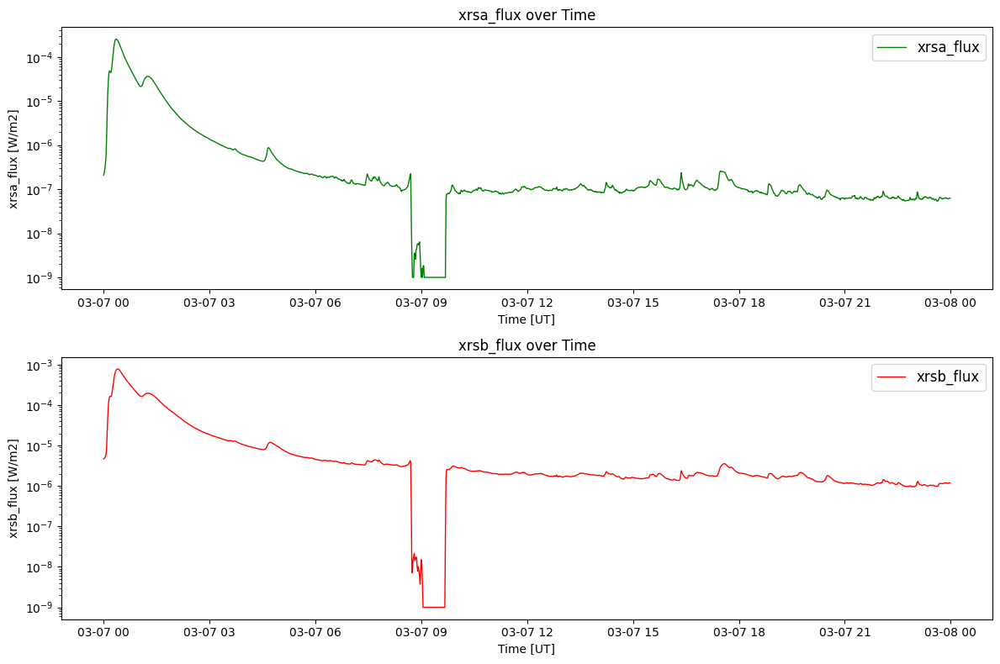

Done.



In [9]:
import netCDF4 as nc
import cftime
import requests
import os
import matplotlib.pyplot as plt
import numpy as np

dir0 = "./"
file0 = "sci_xrsf-l2-avg1m_g15_d20120307_v2-2-0.nc"

# Download file0 if it does not exist locally
if not os.path.exists(dir0 + file0):
    with open(dir0 + file0, "wb") as f:
        url = f"https://www.ncei.noaa.gov/data/goes-space-environment-monitor/access/science/xrs/goes15/xrsf-l2-avg1m_science/2012/03/{file0}"
        print('Downloading: ', url)
        r = requests.get(url)
        f.write(r.content)

# Open the NetCDF file
ds = nc.Dataset(dir0 + file0)

# Inspect the time variable
print("All variable names: ")
print(list(ds.variables.keys()))  # Print all variable names

# Use 'time' as the timestamp variable
times = cftime.num2pydate(ds.variables["time"][:], ds["time"].units)
print("Filename:  ", file0)
print("Start and end times:", times[0], times[-1])

# Check the shape of the variables
var1 = 'xrsa_flux'  # Main flux variable
var3 = 'xrsb_flux'  # Secondary flux variable (xrsa_flux and xrsb_flux)
print(f"Shape of {var1}: {ds.variables[var1].shape}")
print(f"Shape of {var3}: {ds.variables[var3].shape}")

# Extract data for the flux variables
data_flux1 = []
data_flux2 = []

# Adjust indexing for each variable based on its shape
# For xrsa_flux
if len(ds.variables[var1].shape) == 1:  # The variable is 1D
    data_flux1 = ds.variables[var1][:]
elif len(ds.variables[var1].shape) == 2:  # The variable is 2D (time and some other dimension)
    for i in range(0, len(times)):
        data_flux1.append(ds.variables[var1][i])

# For xrsb_flux
if len(ds.variables[var3].shape) == 1:  # The variable is 1D
    data_flux2 = ds.variables[var3][:]
elif len(ds.variables[var3].shape) == 2:  # The variable is 2D (time and some other dimension)
    for i in range(0, len(times)):
        data_flux2.append(ds.variables[var3][i])

# Convert the data to numpy arrays
data_flux1 = np.array(data_flux1)
data_flux2 = np.array(data_flux2)

# Replace non-positive values with a small positive number for flux data (log-scale flux)
data_flux1[data_flux1 <= 0] = 1e-10
data_flux2[data_flux2 <= 0] = 1e-10

# Plotting both flux variables
plt.figure(figsize=[12, 8])

# Plotting the main flux data with log scale (xrsa_flux)
plt.subplot(2, 1, 1)
plt.plot(times[:], data_flux1, linewidth=1, color="green", label=f"{var1}")
plt.yscale("log")
plt.legend(loc="upper right", prop={"size": 12})
plt.xlabel("Time [UT]")
plt.ylabel(f"{var1} [{ds.variables[var1].units}]")
plt.title(f"{var1} over Time")

# Plotting the secondary flux data with log scale (xrsb_flux)
plt.subplot(2, 1, 2)
plt.plot(times[:], data_flux2, linewidth=1, color="red", label=f"{var3}")
plt.yscale("log")
plt.legend(loc="upper right", prop={"size": 12})
plt.xlabel("Time [UT]")
plt.ylabel(f"{var3} [{ds.variables[var3].units}]")
plt.title(f"{var3} over Time")

plt.tight_layout()
plt.show()

print("Done.\n")


downloading:  https://data.ngdc.noaa.gov/platforms/solar-space-observing-satellites/goes/goes16/l2/data/mpsh-l2-avg1m/2020/06/sci_mpsh-l2-avg1m_g16_d20200601_v1-0-2.nc
Filename:   sci_mpsh-l2-avg1m_g16_d20200601_v1-0-2.nc
start and end times: 2020-06-01 00:00:00 2020-06-01 23:59:00

All variable names: 
['L2_SciData_TimeStamp', 'L1bRecordsInAvg', 'YawFlipFlag', 'EclipseFlag', 'AvgDiffProtonFlux', 'AvgDiffProtonFluxUncert', 'DiffProtonValidL1bSamplesInAvg', 'DiffProtonDQFdtcSum', 'DiffProtonDQFoobSum', 'DiffProtonDQFerrSum', 'AvgDiffElectronFlux', 'AvgDiffElectronFluxUncert', 'DiffElectronEffectiveEnergy', 'DiffElectronValidL1bSamplesInAvg', 'DiffElectronDQFdtcSum', 'DiffElectronDQFoobSum', 'DiffElectronDQFerrSum', 'AvgIntElectronFlux', 'AvgIntElectronFluxUncert', 'IntElectronEffectiveEnergy', 'IntValidL1bSamplesInAvg', 'IntDQFdtcSum', 'IntDQFoobSum', 'IntDQFerrSum', 'DiffProtonLowerEnergy', 'DiffProtonUpperEnergy', 'DiffProtonEffectiveEnergy', 'ExpectedLUTNotFound'] 



/usr/local/lib/python3.11/dist-packages/numpy/core/shape_base.py:65: UserWarning: Warning: converting a masked element to nan.
  ary = asanyarray(ary)


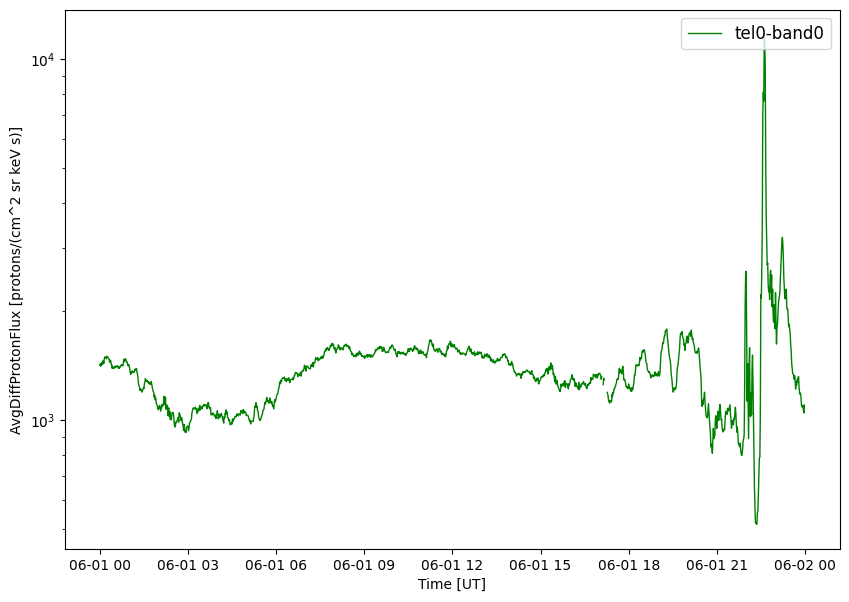

Done.



In [10]:
# Could not find 2012 records!!!!
dir0 = "./"
file0 = "sci_mpsh-l2-avg1m_g16_d20200601_v1-0-2.nc"

# Download `file0` if it does not exist locally
if not os.path.exists(dir0 + file0):
    with open(dir0 + file0, "wb") as f:
        url = f"https://data.ngdc.noaa.gov/platforms/solar-space-observing-satellites/goes/goes16/l2/data/mpsh-l2-avg1m/2020/06/{file0}"
        print('downloading: ', url)
        r = requests.get(url)
        f.write(r.content)

ds = nc.Dataset(dir0 + file0)


times = cftime.num2pydate(ds.variables["L2_SciData_TimeStamp"][:], ds["L2_SciData_TimeStamp"].units)
print("Filename:  ", file0)
print("start and end times:", times[0], times[-1])


print("\nAll variable names: ")
print(list(ds.variables.keys()), "\n")


var = 'AvgDiffProtonFlux'
tel = 0
band = 0
data = []
for i in range(0, len(times)):
    data.append(ds.variables[var][i][tel][band])
plt.figure(0, figsize=[10, 7])
plt.plot(
    times[:],
    data,
    linewidth=1,
    color="green",
    label=f"tel{tel}-band{band}",
)
plt.yscale("log")
plt.legend(loc="upper right", prop={"size": 12})
plt.xlabel("Time [UT]")

plt.ylabel(f"{var} [{ds[var].units}]")
plt.show()
print("Done.\n")

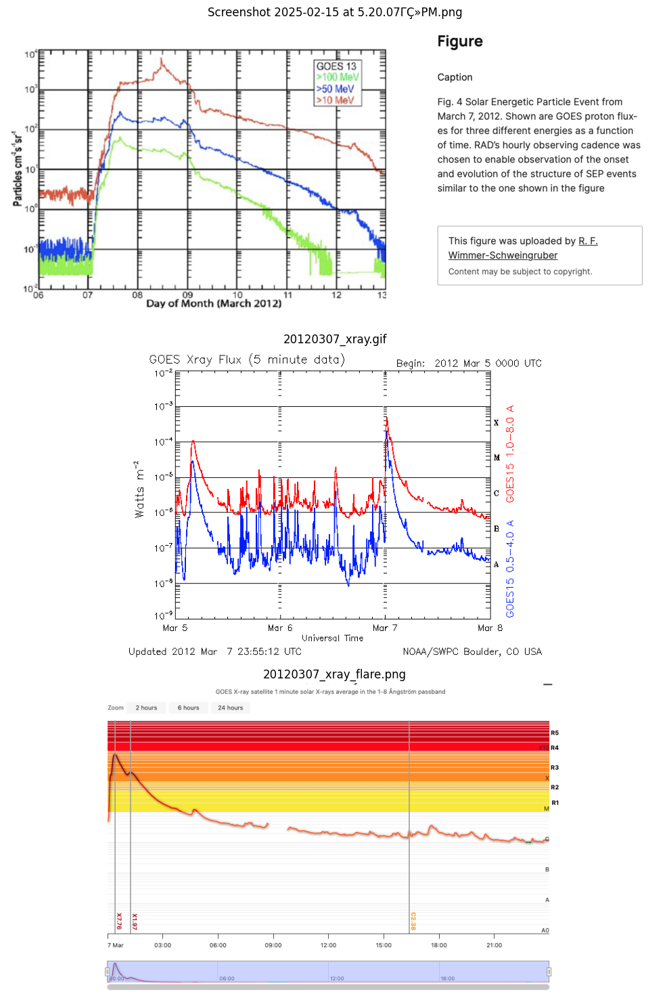

In [11]:
import zipfile
import os
import matplotlib.pyplot as plt
from PIL import Image, UnidentifiedImageError
import numpy as np  # Make sure numpy is imported

# Define ZIP file and extraction folder
zip_path = "xray.zip"
extract_path = "xray_extracted"

# Extract ZIP file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

# Search for valid image files (ignore macOS hidden files)
image_extensions = ('.jpeg', '.jpg', '.png', '.tiff', '.tif', '.gif')
image_files = []

for root, _, files in os.walk(extract_path):
    for file in files:
        if file.lower().endswith(image_extensions) and not file.startswith("._"):
            image_files.append(os.path.join(root, file))  # Save full path

# Print found images
if not image_files:
    print("No valid image files found.")

# Function to display images in 1 column per row
def display_images(image_files, num_images=6):
    num_images = min(num_images, len(image_files))  # Limit to available images
    cols = 1  # 1 image per row
    rows = (num_images + cols - 1) // cols  # Ensure correct number of rows

    fig, axes = plt.subplots(rows, cols, figsize=(10, 5 * rows))

    # Flatten axes if multiple rows, else make it a list
    axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

    for i in range(len(axes)):
        if i < num_images:
            img_path = image_files[i]
            try:
                image = Image.open(img_path)
                axes[i].imshow(image)
                axes[i].axis("off")
                axes[i].set_title(os.path.basename(img_path))
            except UnidentifiedImageError:
                print(f"Skipping invalid image: {img_path}")
                axes[i].axis("off")  # Hide this subplot
        else:
            axes[i].axis("off")  # Hide empty subplots

    plt.tight_layout()
    plt.show()

# Display first few images
if image_files:
    display_images(image_files)